In [194]:
from PIL import Image
import matplotlib.pyplot as plt
import os
import random
import torch
import urllib
from torch.utils.data import Dataset
from torch.utils.data import DataLoader
from tqdm import tqdm
import timm
import requests
from dotenv import load_dotenv
import base64
from transformers import pipeline
import numpy as np
load_dotenv()

True

In [345]:
DATA_DIRECTORY = '../data/raw'

In [196]:
data = {
    folder: [f'{DATA_DIRECTORY}/{folder}/{image}' for image in os.listdir(f'{DATA_DIRECTORY}/{folder}')]
    for folder in os.listdir(DATA_DIRECTORY)
}

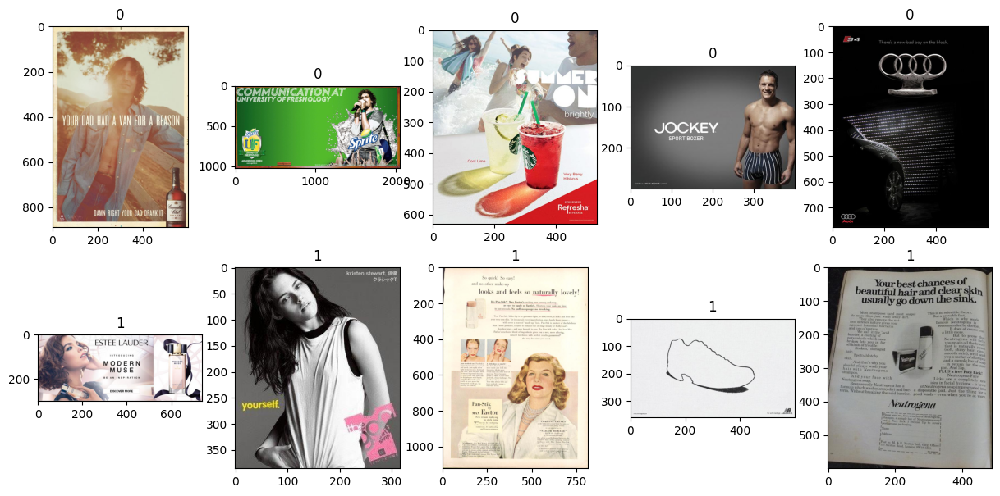

In [197]:
f, ax = plt.subplots(2, 5, figsize=(15, 7))
for i, (folder, images) in enumerate(data.items()):
    for j, image in enumerate(random.choices(images, k=5)):
        with Image.open(image) as im:
            ax[i, j].imshow(im)
            ax[i, j].set_title(folder)

In [265]:
class CustomImageDataset(Dataset):
    def __init__(self, paths, transforms):
        self.transform = transforms
        self.images = []
        for images in paths.values():
            self.images.extend(images)

    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        image = Image.open(self.images[idx]).convert('RGB')
        if self.transform:
            image = self.transform(image)
        return image, idx

In [199]:
device = torch.device('mps')
model = timm.create_model('tf_efficientnet_b4_ns', pretrained=True)
model = model.eval()
model = model.to(device)

/Users/dmitriimaksimov/Desktop/GitHub/Qdrant_task/.venv/lib/python3.10/site-packages/timm/models/_factory.py:117: UserWarning: Mapping deprecated model name tf_efficientnet_b4_ns to current tf_efficientnet_b4.ns_jft_in1k.
  model = create_fn(


In [200]:
data_config = timm.data.resolve_data_config(model.pretrained_cfg)
transforms = timm.data.create_transform(**data_config, is_training=False)

In [201]:
url, filename = ("https://raw.githubusercontent.com/pytorch/hub/master/imagenet_classes.txt", "imagenet_classes.txt")
urllib.request.urlretrieve(url, filename) 
with open("imagenet_classes.txt", "r") as f:
    categories = [s.strip() for s in f.readlines()]

In [202]:
batch_size = 8
dataset = CustomImageDataset(data, transforms)
loader = DataLoader(dataset, batch_size=batch_size, shuffle=False)

In [203]:
threshold = 0.85
labeled_data_imagenet = {}
with torch.no_grad():
    for tensor, idxs in tqdm(loader):
        tensor = tensor.to(device)
        out = model(tensor)
        probabilities = torch.nn.functional.softmax(out, dim=1)
        top_prob, top_catid = torch.topk(probabilities.to('cpu'), 1)
        mask = top_prob.squeeze() > threshold
        for catid, idx in zip(top_catid.squeeze()[mask], idxs[mask]):
            labeled_data_imagenet[idx.item()] = categories[catid]

100%|██████████| 1389/1389 [04:59<00:00,  4.64it/s]


In [204]:
print(len(labeled_data_imagenet))

218


In [205]:
print(len(set(labeled_data_imagenet.values())))

66


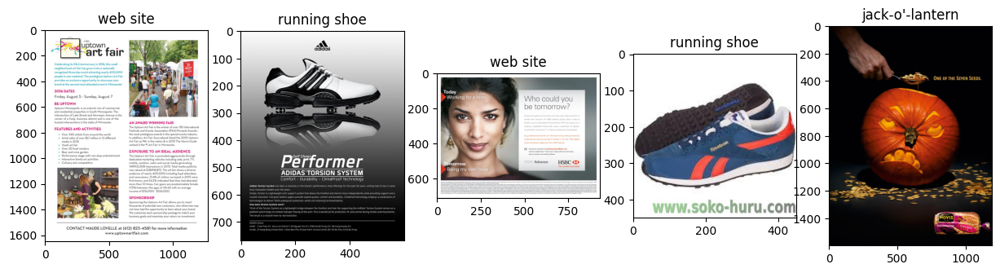

In [206]:
f, ax = plt.subplots(1, 5, figsize=(15, 7))
for j, image in enumerate(random.choices(list(labeled_data_imagenet), k=5)):
    with Image.open(dataset.images[image]) as im:
        ax[j].imshow(im)
        ax[j].set_title(labeled_data_imagenet[image])

In [207]:
image_to_text = pipeline("image-to-text", model="nlpconnect/vit-gpt2-image-captioning", device='cpu')

Could not find image processor class in the image processor config or the model config. Loading based on pattern matching with the model's feature extractor configuration. Please open a PR/issue to update `preprocessor_config.json` to use `image_processor_type` instead of `feature_extractor_type`. This warning will be removed in v4.40.
/Users/dmitriimaksimov/Desktop/GitHub/Qdrant_task/.venv/lib/python3.10/site-packages/transformers/models/vit/feature_extraction_vit.py:28: FutureWarning: The class ViTFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use ViTImageProcessor instead.
  warnings.warn(


In [208]:
labeled_data_llm_local = {}
random_images = random.choices(range(len(dataset)), k=10)
for i in tqdm(random_images):
    res = image_to_text(dataset.images[i])
    labeled_data_llm_local[i] = res[0]['generated_text']

  0%|          | 0/10 [00:00<?, ?it/s]/Users/dmitriimaksimov/Desktop/GitHub/Qdrant_task/.venv/lib/python3.10/site-packages/transformers/generation/utils.py:1133: UserWarning: Using the model-agnostic default `max_length` (=20) to control the generation length. We recommend setting `max_new_tokens` to control the maximum length of the generation.
  warnings.warn(
100%|██████████| 10/10 [00:05<00:00,  1.98it/s]


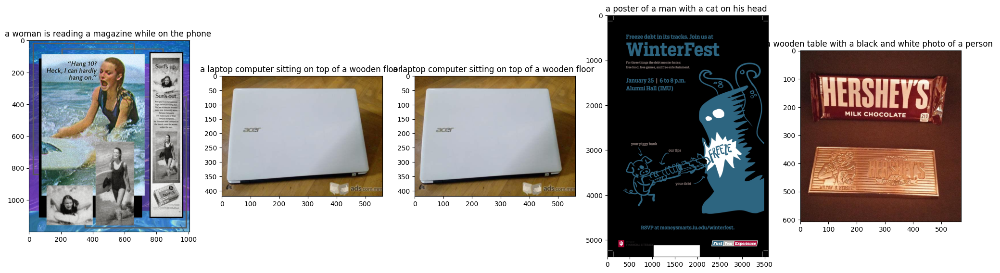

In [209]:
f, ax = plt.subplots(1, 5, figsize=(25, 7))
for j, image in enumerate(random.choices(list(labeled_data_llm_local), k=5)):
    with Image.open(dataset.images[image]) as im:
        ax[j].imshow(im)
        ax[j].set_title(labeled_data_llm_local[image])

In [210]:
def get_questions(image):
    prompt_template = f"""
    Analyze the following image and generate a short text that matches this image.
    If you believe the image is an advertisement, simply write the product being advertised here. Do not provide an explanation in any case!
    """
    headers = {
        "Content-Type": "application/json",
        "Authorization": f"Bearer {os.getenv('OPENAI_API_KEY')}"
    }

    payload = {
        "model": "gpt-4-vision-preview",
        "messages": [
            {
                "role": "user",
                "content": [
                    {
                        "type": "text",
                        "text": prompt_template
                    },
                    {
                        "type": "image_url",
                        "image_url": {
                            "url": f"data:image/jpeg;base64,{image}"
                        }
                    }
                ]
            }
        ],
        "max_tokens": 30,
        "temperature": 0.85,
        "top_p": 0.9,
    }

    response = requests.post("https://api.openai.com/v1/chat/completions", headers=headers, json=payload)
    return response.json()

In [211]:
labeled_data_llm_openai = {}
for i in tqdm(random_images):
    with open(dataset.images[i], "rb") as image_file:
        im = base64.b64encode(image_file.read()).decode('utf-8')
        res = get_questions(im)
        labeled_data_llm_openai[i] = res['choices'][0]['message']['content']
        

100%|██████████| 10/10 [00:30<00:00,  3.08s/it]


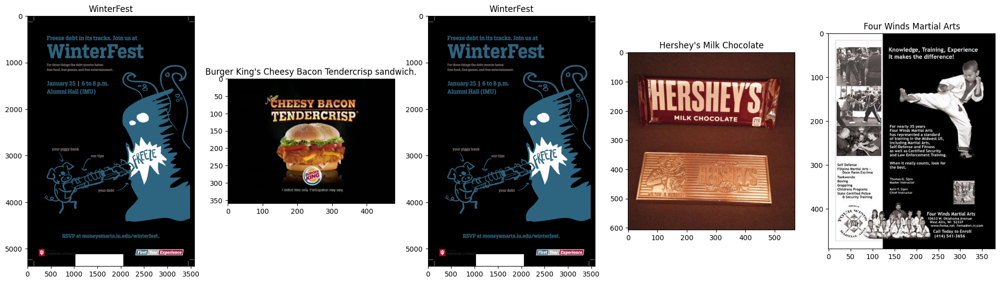

In [212]:
f, ax = plt.subplots(1, 5, figsize=(25, 7))
for j, image in enumerate(random.choices(list(labeled_data_llm_openai), k=5)):
    with Image.open(dataset.images[image]) as im:
        ax[j].imshow(im)
        ax[j].set_title(labeled_data_llm_openai[image])

In [213]:
import open_clip

In [214]:
open_clip.list_pretrained()

[('RN50', 'openai'),
 ('RN50', 'yfcc15m'),
 ('RN50', 'cc12m'),
 ('RN50-quickgelu', 'openai'),
 ('RN50-quickgelu', 'yfcc15m'),
 ('RN50-quickgelu', 'cc12m'),
 ('RN101', 'openai'),
 ('RN101', 'yfcc15m'),
 ('RN101-quickgelu', 'openai'),
 ('RN101-quickgelu', 'yfcc15m'),
 ('RN50x4', 'openai'),
 ('RN50x16', 'openai'),
 ('RN50x64', 'openai'),
 ('ViT-B-32', 'openai'),
 ('ViT-B-32', 'laion400m_e31'),
 ('ViT-B-32', 'laion400m_e32'),
 ('ViT-B-32', 'laion2b_e16'),
 ('ViT-B-32', 'laion2b_s34b_b79k'),
 ('ViT-B-32', 'datacomp_xl_s13b_b90k'),
 ('ViT-B-32', 'datacomp_m_s128m_b4k'),
 ('ViT-B-32', 'commonpool_m_clip_s128m_b4k'),
 ('ViT-B-32', 'commonpool_m_laion_s128m_b4k'),
 ('ViT-B-32', 'commonpool_m_image_s128m_b4k'),
 ('ViT-B-32', 'commonpool_m_text_s128m_b4k'),
 ('ViT-B-32', 'commonpool_m_basic_s128m_b4k'),
 ('ViT-B-32', 'commonpool_m_s128m_b4k'),
 ('ViT-B-32', 'datacomp_s_s13m_b4k'),
 ('ViT-B-32', 'commonpool_s_clip_s13m_b4k'),
 ('ViT-B-32', 'commonpool_s_laion_s13m_b4k'),
 ('ViT-B-32', 'commonpool_

In [299]:
model, _, transform = open_clip.create_model_and_transforms(
  model_name="ViT-B-16-SigLIP",
  pretrained="webli"
)

In [300]:
batch_size = 16
dataset = CustomImageDataset(data, transform)
loader = DataLoader(dataset, batch_size=batch_size, shuffle=False)

In [301]:
model = model.eval()
model = model.to(device)

In [302]:
image_embeddings = []
with torch.no_grad(), torch.cuda.amp.autocast():
    for image, idx in tqdm(loader):
        image = image.to(device)
        image_features = model.encode_image(image)
        image_features /= image_features.norm(dim=-1, keepdim=True)
        image_embeddings.append(image_features.to('cpu').numpy())

/Users/dmitriimaksimov/Desktop/GitHub/Qdrant_task/.venv/lib/python3.10/site-packages/torch/amp/autocast_mode.py:250: UserWarning: User provided device_type of 'cuda', but CUDA is not available. Disabling
  warnings.warn(
100%|██████████| 695/695 [04:59<00:00,  2.32it/s]


In [307]:
image_embeddings = np.vstack(image_embeddings)

In [308]:
tokenizer = open_clip.get_tokenizer('ViT-B-16-SigLIP')

In [317]:
def retrieve(data, top_k):
    text_embeddings = []
    with torch.no_grad(), torch.cuda.amp.autocast():
        for text in tqdm(data.values()):
            text = tokenizer(text).to(device)
            text_features = model.encode_text(text)
            text_features /= text_features.norm(dim=-1, keepdim=True)
            text_embeddings.append(text_features.to('cpu').numpy())

    text_embeddings = np.vstack(text_embeddings)
    similarity = np.matmul(text_embeddings, image_embeddings.T)
    image_probs = torch.softmax(torch.tensor(similarity), dim=1).numpy() * 100

    for i, image in enumerate(list(data)[:5]):
        f, ax = plt.subplots(1, top_k + 1, figsize=(25, 7))
        text = data[image]
        f.suptitle(text, fontsize=16)
        with Image.open(dataset.images[image]) as im:
            ax[0].imshow(im)
            ax[0].set_title('expected')
        top_k_images = image_probs[i].argsort()[-top_k:][::-1]
        for j in range(top_k):
            with Image.open(dataset.images[top_k_images[j]]) as im:
                ax[j + 1].imshow(im)
                ax[j + 1].set_title(f'predicted: #{j + 1}, prob: {image_probs[i, top_k_images[j]]:.2f}%')
    plt.show()

/Users/dmitriimaksimov/Desktop/GitHub/Qdrant_task/.venv/lib/python3.10/site-packages/torch/amp/autocast_mode.py:250: UserWarning: User provided device_type of 'cuda', but CUDA is not available. Disabling
  warnings.warn(
100%|██████████| 218/218 [00:04<00:00, 50.55it/s]


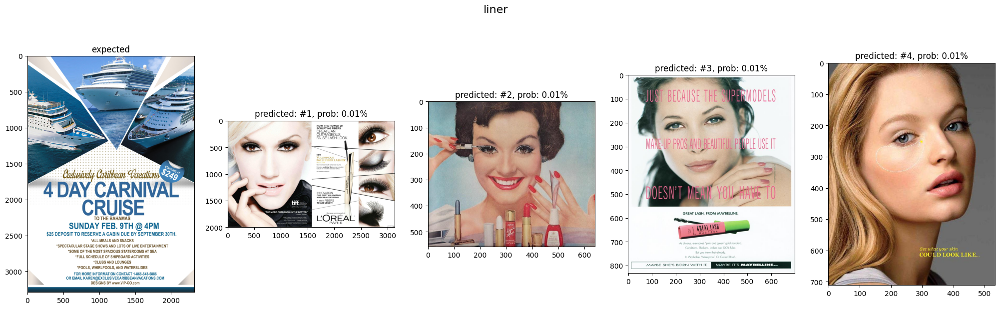

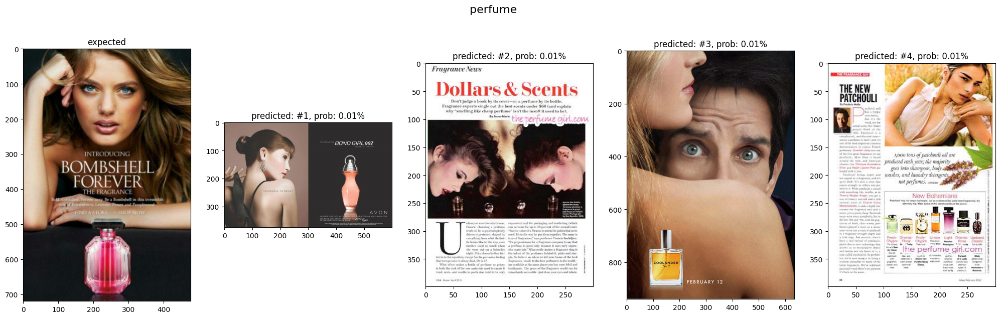

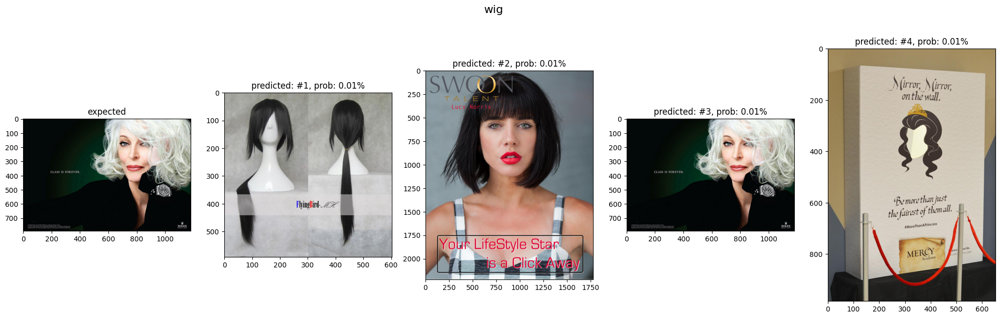

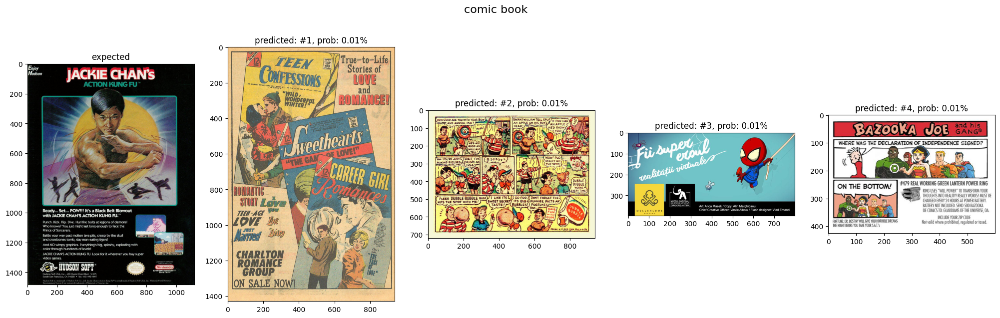

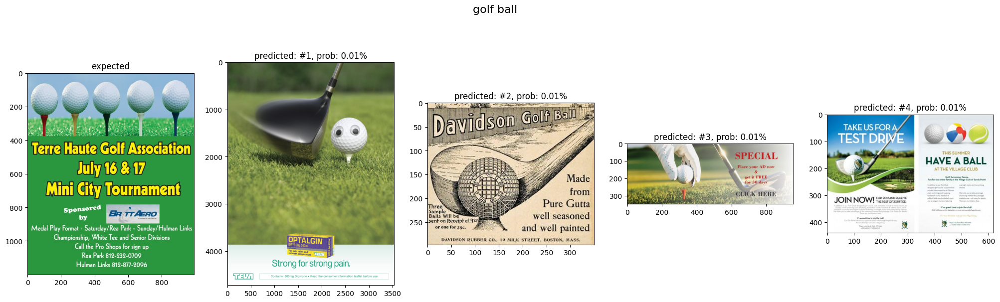

In [318]:
retrieve(labeled_data_imagenet, 4)

/Users/dmitriimaksimov/Desktop/GitHub/Qdrant_task/.venv/lib/python3.10/site-packages/torch/amp/autocast_mode.py:250: UserWarning: User provided device_type of 'cuda', but CUDA is not available. Disabling
  warnings.warn(
100%|██████████| 10/10 [00:00<00:00, 33.09it/s]


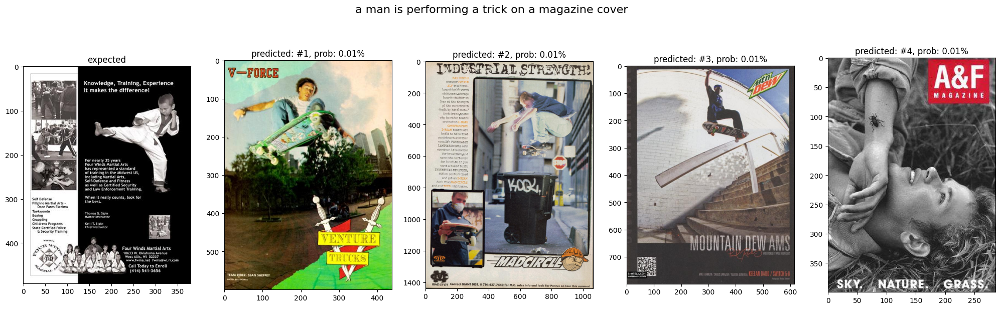

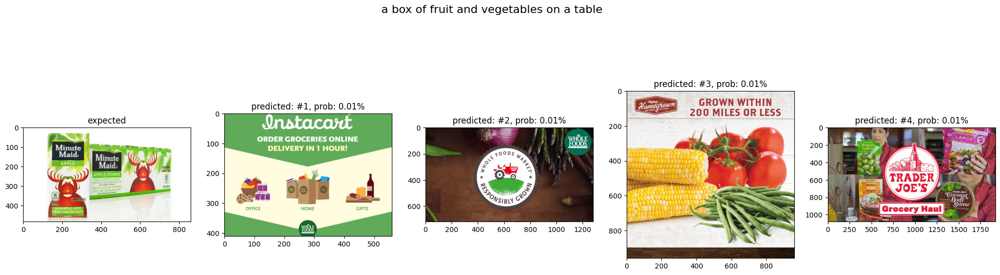

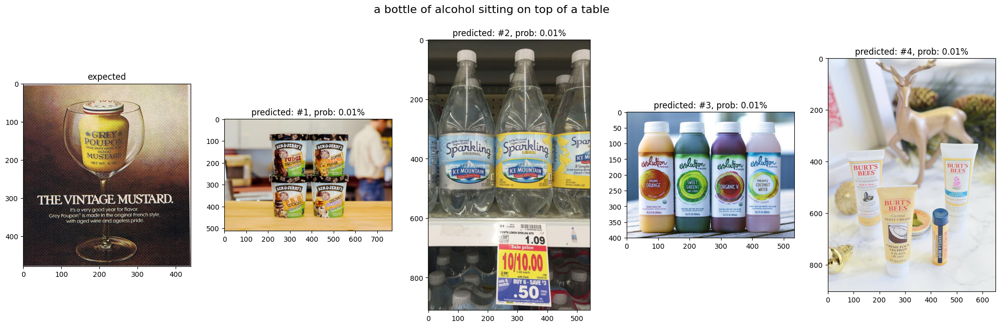

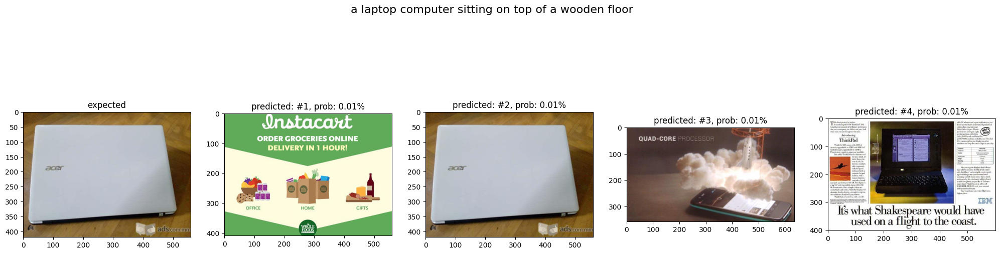

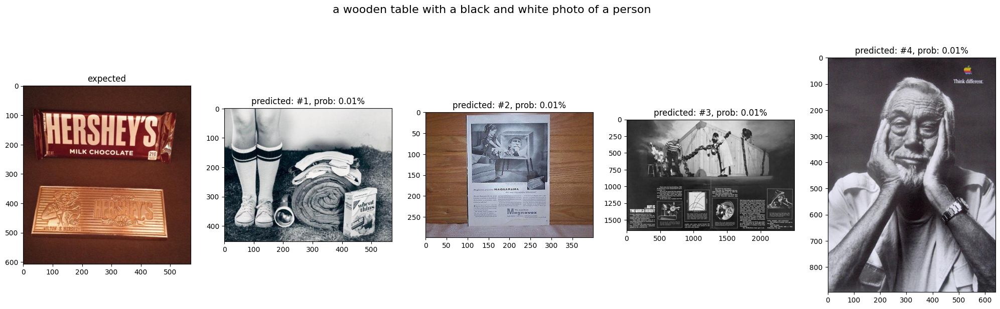

In [319]:
retrieve(labeled_data_llm_local, 4)

/Users/dmitriimaksimov/Desktop/GitHub/Qdrant_task/.venv/lib/python3.10/site-packages/torch/amp/autocast_mode.py:250: UserWarning: User provided device_type of 'cuda', but CUDA is not available. Disabling
  warnings.warn(
100%|██████████| 10/10 [00:00<00:00, 32.08it/s]


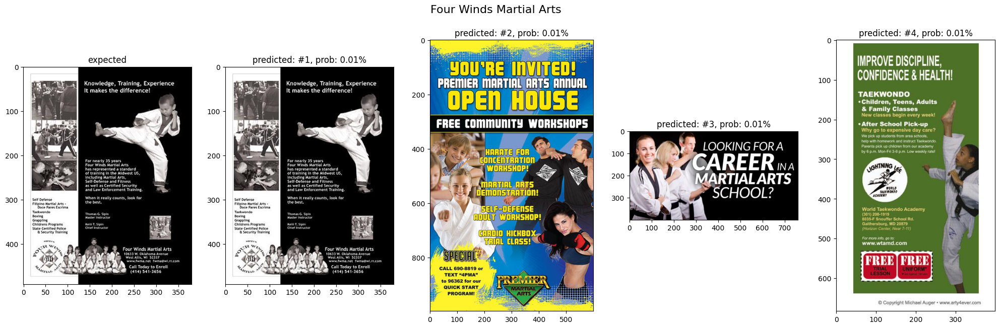

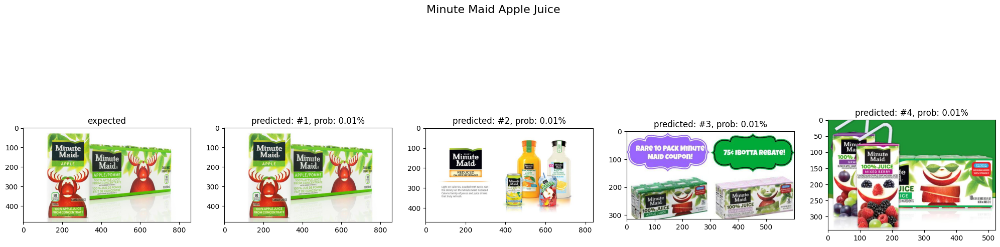

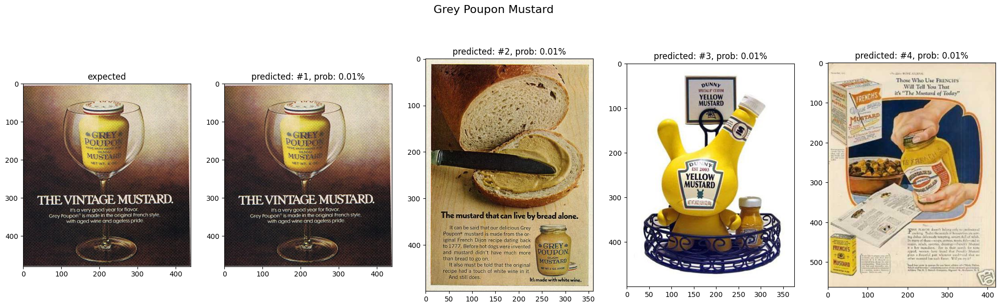

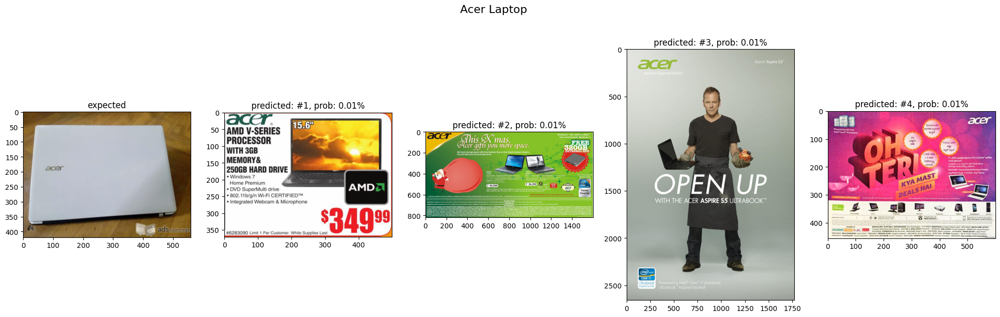

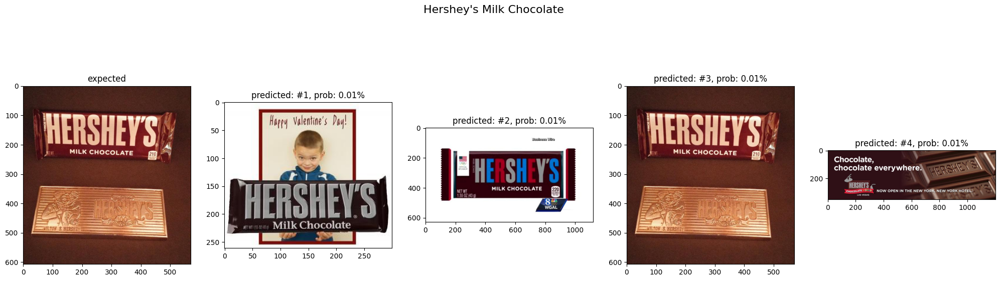

In [320]:
retrieve(labeled_data_llm_openai, 4)

In [325]:
def calculate_mrr(similarity_matrix, relevant_indices):
    num_queries = similarity_matrix.shape[0]
    reciprocal_ranks = []

    for i in range(num_queries):
        sorted_indices = np.argsort(similarity_matrix[i])[::-1]
        
        rank = np.where(sorted_indices == relevant_indices[i])[0][0] + 1  # Add 1 because ranks start at 1
        reciprocal_ranks.append(1.0 / rank)

    return reciprocal_ranks

In [339]:
def calculate_hit_rate_at_k(similarity_matrix, relevant_indices, k):
    num_queries = similarity_matrix.shape[0]
    hits = []

    for i in range(num_queries):
        sorted_indices = np.argsort(similarity_matrix[i])[::-1]
        hits.append(1 if relevant_indices[i] in sorted_indices[:k] else 0)

    return hits

In [340]:
text_embeddings = []
with torch.no_grad(), torch.cuda.amp.autocast():
    for text in tqdm(labeled_data_llm_openai.values()):
        text = tokenizer(text).to(device)
        text_features = model.encode_text(text)
        text_features /= text_features.norm(dim=-1, keepdim=True)
        text_embeddings.append(text_features.to('cpu').numpy())

text_embeddings = np.vstack(text_embeddings)
similarity = np.matmul(text_embeddings, image_embeddings.T)

/Users/dmitriimaksimov/Desktop/GitHub/Qdrant_task/.venv/lib/python3.10/site-packages/torch/amp/autocast_mode.py:250: UserWarning: User provided device_type of 'cuda', but CUDA is not available. Disabling
  warnings.warn(
100%|██████████| 10/10 [00:00<00:00, 30.93it/s]


In [327]:
mrr = calculate_mrr(similarity, list(labeled_data_llm_openai))

In [341]:
hit_rate = calculate_hit_rate_at_k(similarity, list(labeled_data_llm_openai), 4)

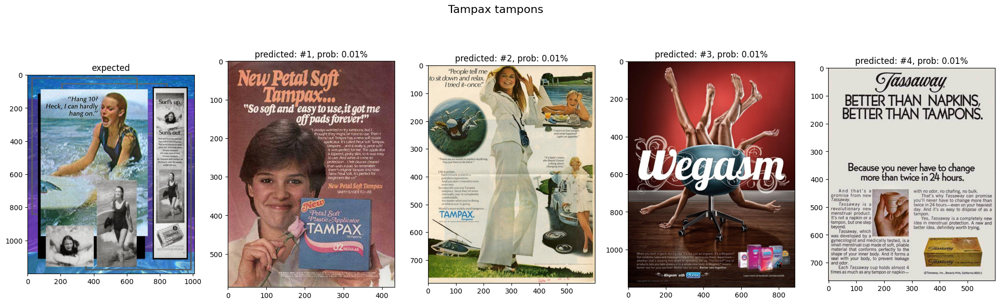

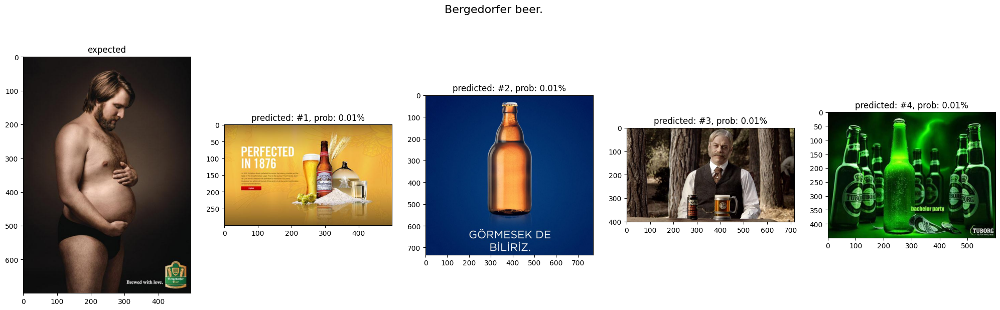

In [338]:
top_k = 4
image_probs = torch.softmax(torch.tensor(similarity), dim=1).numpy() * 100

for i, i_text in enumerate(np.argsort(mrr)[:2]):
    image = list(labeled_data_llm_openai)[i_text]
    f, ax = plt.subplots(1, top_k + 1, figsize=(25, 7))
    text = labeled_data_llm_openai[image]
    f.suptitle(text, fontsize=16)
    with Image.open(dataset.images[image]) as im:
        ax[0].imshow(im)
        ax[0].set_title('expected')
    top_k_images = image_probs[i_text].argsort()[-top_k:][::-1]
    for j in range(top_k):
        with Image.open(dataset.images[top_k_images[j]]) as im:
            ax[j + 1].imshow(im)
            ax[j + 1].set_title(f'predicted: #{j + 1}, prob: {image_probs[i, top_k_images[j]]:.2f}%')

# Conclusions

- The dataset comprises images of varying sizes
- Some images contain a substantial amount of text, while others only a few words
- The dataset likely consists of advertising images with text or something similar
- It's possible to use pretrained ImageNet models to label images. However, it should be noted that there is a set of images, rather than just a single image, that are relevant to each specific class
- Employing small image-to-text models is not advisable, as they often produce inaccurate text
- We can leverage OpenAI's multimodal model for generating text from images. This approach is chosen due to the lack of sufficient local resources for running large models, while utilizing OpenAI's API is a viable paid alternative
- Small OpenCLIP models can be effective for retrieving relevant images from the dataset
- Fine-tuning the OpenCLIP model is a good idea, considering the minimal difference in probabilities between relevant and irrelevant images
- The HitRate@K and Mean Reciprocal Rank metrics are suitable for evaluating the model's quality